# Preliminary Exploratory Data Analysis

## Imports

In [20]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors
from sklearn.manifold import TSNE

pd.set_option('display.max_rows', 50)
pd.set_option('display.max_columns', 100)

In [12]:
df = pd.read_csv('drugs.csv')
print(f'Missing values: {df.isna().sum().sum()}')
print(df.shape)
display(df.head())
display(df.describe())

Missing values: 0
(867, 53)


,State,Year,Population.12-17,Population.18-25,Population.26+,Totals.Alcohol.Use Disorder Past Year.12-17,Totals.Alcohol.Use Disorder Past Year.18-25,Totals.Alcohol.Use Disorder Past Year.26+,Rates.Alcohol.Use Disorder Past Year.12-17,Rates.Alcohol.Use Disorder Past Year.18-25,Rates.Alcohol.Use Disorder Past Year.26+,Totals.Alcohol.Use Past Month.12-17,Totals.Alcohol.Use Past Month.18-25,Totals.Alcohol.Use Past Month.26+,Rates.Alcohol.Use Past Month.12-17,Rates.Alcohol.Use Past Month.18-25,Rates.Alcohol.Use Past Month.26+,Totals.Tobacco.Cigarette Past Month.12-17,Totals.Tobacco.Cigarette Past Month.18-25,Totals.Tobacco.Cigarette Past Month.26+,Rates.Tobacco.Cigarette Past Month.12-17,Rates.Tobacco.Cigarette Past Month.18-25,Rates.Tobacco.Cigarette Past Month.26+,Totals.Illicit Drugs.Cocaine Used Past Year.12-17,Totals.Illicit Drugs.Cocaine Used Past Year.18-25,Totals.Illicit Drugs.Cocaine Used Past Year.26+,Rates.Illicit Drugs.Cocaine Used Past Year.12-17,Rates.Illicit Drugs.Cocaine Used Past Year.18-25,Rates.Illicit Drugs.Cocaine Used Past Year.26+,Totals.Marijuana.New Users.12-17,Totals.Marijuana.New Users.18-25,Totals.Marijuana.New Users.26+,Rates.Marijuana.New Users.12-17,Rates.Marijuana.New Users.18-25,Rates.Marijuana.New Users.26+,Totals.Marijuana.Used Past Month.12-17,Totals.Marijuana.Used Past Month.18-25,Totals.Marijuana.Used Past Month.26+,Rates.Marijuana.Used Past Month.12-17,Rates.Marijuana.Used Past Month.18-25,Rates.Marijuana.Used Past Month.26+,Totals.Marijuana.Used Past Year.12-17,Totals.Marijuana.Used Past Year.18-25,Totals.Marijuana.Used Past Year.26+,Rates.Marijuana.Used Past Year.12-17,Rates.Marijuana.Used Past Year.18-25,Rates.Marijuana.Used Past Year.26+,Totals.Tobacco.Use Past Month.12-17,Totals.Tobacco.Use Past Month.18-25,Totals.Tobacco.Use Past Month.26+,Rates.Tobacco.Use Past Month.12-17,Rates.Tobacco.Use Past Month.18-25,Rates.Tobacco.Use Past Month.26+
0,Alabama,2002,380805,499453,2812905,18,68,138,48.336,136.490,49.068,57,254,1048,150.033,509.551,372.703,52,196,728,136.906,392.404,258.844,6,27,49,16.556,54.892,17.513,20,18,2,59.732,62.325,0.914,24,62,73,63.662,124.672,25.967,49,119,141,127.535,237.880,50.275,63,226,930,166.578,451.976,330.659
1,Alaska,2002,69400,62791,368460,4,12,27,61.479,187.891,73.677,11,38,206,158.988,598.311,559.151,9,28,92,132.517,439.749,249.578,2,5,5,24.400,83.680,13.838,4,2,0,77.736,84.250,1.625,8,15,26,110.781,239.907,71.362,13,24,46,188.730,389.026,124.566,11,30,112,163.918,484.270,304.220
2,Arizona,2002,485521,602265,3329482,36,117,258,73.819,193.626,77.521,91,352,1774,186.864,584.521,532.858,62,234,919,128.357,388.473,275.990,16,51,86,32.411,85.300,25.683,25,18,3,64.179,60.101,1.364,38,91,122,77.371,151.780,36.657,82,166,215,169.646,275.435,64.640,73,240,1032,151.071,397.968,309.969
3,Arkansas,2002,232986,302029,1687337,14,53,101,61.457,175.913,59.810,39,162,664,167.065,537.894,393.372,37,154,539,160.479,509.682,319.224,4,18,26,18.643,60.500,15.187,13,10,1,66.710,71.089,0.991,19,50,57,79.670,164.807,33.891,37,87,104,157.567,288.856,61.510,46,169,660,195.714,558.846,391.210
4,California,2002,3140739,3919577,21392421,173,581,1298,55.109,148.312,60.692,480,2176,11847,152.791,555.278,553.801,235,1245,4028,74.824,317.661,188.269,53,259,410,16.995,66.052,19.184,158,126,17,58.786,62.674,1.437,241,631,978,76.595,160.916,45.736,443,1109,1670,141.067,282.887,78.068,290,1377,4721,92.235,351.353,220.699


,Year,Population.12-17,Population.18-25,Population.26+,Totals.Alcohol.Use Disorder Past Year.12-17,Totals.Alcohol.Use Disorder Past Year.18-25,Totals.Alcohol.Use Disorder Past Year.26+,Rates.Alcohol.Use Disorder Past Year.12-17,Rates.Alcohol.Use Disorder Past Year.18-25,Rates.Alcohol.Use Disorder Past Year.26+,Totals.Alcohol.Use Past Month.12-17,Totals.Alcohol.Use Past Month.18-25,Totals.Alcohol.Use Past Month.26+,Rates.Alcohol.Use Past Month.12-17,Rates.Alcohol.Use Past Month.18-25,Rates.Alcohol.Use Past Month.26+,Totals.Tobacco.Cigarette Past Month.12-17,Totals.Tobacco.Cigarette Past Month.18-25,Totals.Tobacco.Cigarette Past Month.26+,Rates.Tobacco.Cigarette Past Month.12-17,Rates.Tobacco.Cigarette Past Month.18-25,Rates.Tobacco.Cigarette Past Month.26+,Totals.Illicit Drugs.Cocaine Used Past Year.12-17,Totals.Illicit Drugs.Cocaine Used Past Year.18-25,Totals.Illicit Drugs.Cocaine Used Past Year.26+,Rates.Illicit Drugs.Cocaine Used Past Year.12-17,Rates.Illicit Drugs.Cocaine Used Past Year.18-25,Rates.Illicit Drugs.Cocaine Used Past Year.26+,Totals.Marijuana.New Users.12-17,Totals.Marijuana.New Users.18-25,Totals.Marijuana.New Users.26+,Rates.Marijuana.New Users.12-17,Rates.Marijuana.New Users.18-25,Rates.Marijuana.New Users.26+,Totals.Marijuana.Used Past Month.12-17,Totals.Marijuana.Used Past Month.18-25,Totals.Marijuana.Used Past Month.26+,Rates.Marijuana.Used Past Month.12-17,Rates.Marijuana.Used Past Month.18-25,Rates.Marijuana.Used Past Month.26+,Totals.Marijuana.Used Past Year.12-17,Totals.Marijuana.Used Past Year.18-25,Totals.Marijuana.Used Past Year.26+,Rates.Marijuana.Used Past Year.12-17,Rates.Marijuana.Used Past Year.18-25,Rates.Marijuana.Used Past Year.26+,Totals.Tobacco.Use Past Month.12-17,Totals.Tobacco.Use Past Month.18-25,Totals.Tobacco.Use Past Month.26+,Rates.Tobacco.Use Past Month.12-17,Rates.Tobacco.Use Past Month.18-25,Rates.Tobacco.Use Past Month.26+
count,867.000000,8.670000e+02,8.670000e+02,8.670000e+02,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000,867.000000
mean,2010.000000,4.897141e+05,6.588800e+05,3.874155e+06,19.224913,94.482122,224.147636,40.949511,151.180014,59.767603,65.801615,393.018454,2124.662053,136.808842,608.283817,550.402490,36.802768,209.935409,857.223760,81.596408,336.812463,231.258186,5.062284,37.107266,59.107266,10.280396,56.923988,14.968755,24.720877,24.698962,5.534025,59.423725,77.003473,2.781622,34.862745,123.241061,216.134948,73.555033,191.704674,57.492352,65.553633,202.540946,348.762399,138.027751,314.068905,91.916272,47.513264,249.241061,1029.912341,106.241322,402.758178,279.926587
std,4.901807,5.637959e+05,7.559898e+05,4.320776e+06,25.290532,108.272774,254.022992,18.241042,38.558341,9.945844,77.675941,440.005456,2372.867026,36.796413,77.998868,79.149397,41.881683,219.532009,844.418533,37.050359,77.792978,38.918082,7.512625,46.663047,72.738872,5.499766,18.145774,5.256846,28.668860,29.330923,8.920210,11.575087,19.340783,2.348711,41.581227,147.847054,290.392438,16.959938,53.395470,28.027946,76.861339,237.624156,449.851031,25.662836,66.664587,37.791885,51.334800,253.201192,1001.450163,42.548930,79.266735,47.035776
min,2002.000000,3.055100e+04,5.739500e+04,3.101100e+05,0.000000,6.000000,19.000000,12.143000,71.218000,33.838000,3.000000,32.000000,167.000000,50.921000,303.587000,280.761000,1.000000,14.000000,76.000000,12.313000,132.396000,123.298000,0.000000,2.000000,2.000000,1.838000,18.345000,5.303000,2.000000,2.000000,0.000000,27.886000,29.575000,0.553000,2.000000,8.000000,10.000000,36.750000,77.419000,18.973000,4.0000

In [14]:
X = df.drop(columns=['State', 'Year'])
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
df_scaled = pd.concat([df[['State', 'Year']], pd.DataFrame(X_scaled, columns=df.drop(columns=['State', 'Year']).columns)], axis=1)

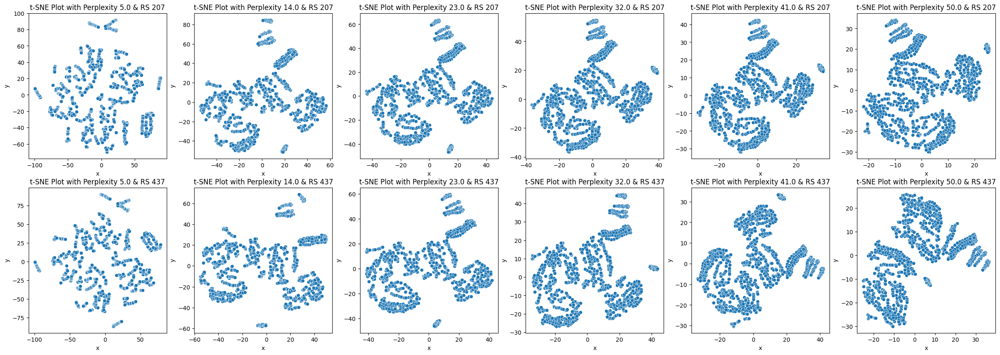

In [17]:
_, axes = plt.subplots(nrows=2, ncols=6, figsize=(30, 10))
for col, perp in enumerate(np.linspace(5, 50, 6)):
    for row, rs in enumerate((207, 437)):
        ax = axes[row, col]
        tsne = TSNE(
            n_components=2, init='random',
            perplexity=perp, random_state=rs
        )
        data_tsne = tsne.fit_transform(X_scaled)
        df_tsne = pd.DataFrame(data_tsne, columns=['x', 'y'])
        sns.scatterplot(x='x', y='y', data=df_tsne, ax=ax)
        ax.set_title(f't-SNE Plot with Perplexity {perp} & RS {rs}')
plt.show()

In [19]:
sns.pairplot(df_scaled.drop(columns=['State', 'Year']))

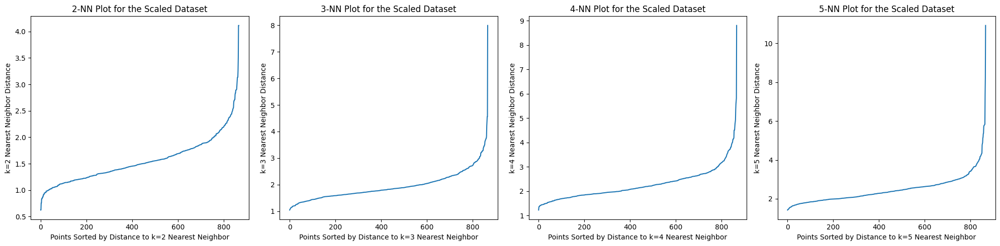

In [24]:
_, axes = plt.subplots(nrows=1, ncols=4, figsize=(20, 5))
for i, k in enumerate(range(2, 6)):
    ax = axes[i]
    nbrs = NearestNeighbors(n_neighbors=k, algorithm='ball_tree').fit(X_scaled)
    distances, indices = nbrs.kneighbors(X_scaled)
    ax.plot(np.sort(distances.T[k-1]))
    ax.set_xlabel(f'Points Sorted by Distance to k={k} Nearest Neighbor')
    ax.set_ylabel(f'k={k} Nearest Neighbor Distance')
    ax.set_title(f'{k}-NN Plot for the Scaled Dataset')
plt.tight_layout()
plt.show()